<a href="https://colab.research.google.com/github/laume/get_pet_images/blob/master/get_pet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![alt text](https://images.unsplash.com/photo-1543554618-7e19c5e393d9?ixlib=rb-1.2.1&ixid=eyJhcHBfaWQiOjEyMDd9&auto=format&fit=crop&w=800&q=60)


# GetPet photo classifier

## Setup

In [2]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [0]:
SETUP = True

In [4]:
import os

try:
    %tensorflow_version 2.x
    %matplotlib inline
except:
    %load_ext lab_black
    os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
    os.environ["CUDA_VISIBLE_DEVICES"] = "0"

TensorFlow 2.x selected.


In [0]:
%matplotlib inline

In [6]:
if SETUP:
    !pip install -q -U dlai
    !pip install -q -U toai
    !pip install -q -U nb_black

    print(__import__("toai").__version__)
    print(f'dlai version: {__import__("dlai").__version__}')

     |████████████████████████████████| 81kB 3.6MB/s 
     |████████████████████████████████| 552kB 9.5MB/s 
     |████████████████████████████████| 296kB 22.4MB/s 
     |████████████████████████████████| 153kB 29.4MB/s 
     |████████████████████████████████| 102kB 10.6MB/s 
     |████████████████████████████████| 122kB 22.6MB/s 
     |████████████████████████████████| 61kB 8.0MB/s 
     |████████████████████████████████| 747kB 28.1MB/s 
ERROR: tensor2tensor 1.14.1 has requirement tensorflow-probability==0.7.0, but you'll have tensorflow-probability 0.9.0 which is incompatible.
ERROR: google-colab 1.0.0 has requirement google-auth~=1.7.2, but you'll have google-auth 1.11.0 which is incompatible.
ERROR: google-colab 1.0.0 has requirement requests~=2.21.0, but you'll have requests 2.22.0 which is incompatible.
ERROR: google-colab 1.0.0 has requirement six~=1.12.0, but you'll have six 1.14.0 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have f

In [7]:
import dlai
from dlai.imports import *
import tensorflow as tf
from tensorflow import keras
from toai.imports import *
from toai.data import DataContainer
from toai.image import ImageAugmentor, ImageParser, ImageResizer, ImageDataContainer
from toai.data.utils import split_df
from toai.encode import CategoricalEncoder
from typing import *
import tensorflow as tf
from tensorflow import keras
import tensorflow_datasets as tfds
import tensorflow_hub as hub
from glob import glob
from matplotlib.patches import Rectangle
from skimage.transform import resize

/usr/local/lib/python3.6/dist-packages/toai/imports.py:69: UserWarning: Could not find kaggle.json. Make sure it's located in /root/.kaggle. Or use the environment method.
  warnings.warn(str(error))


In [0]:
DATA_DIR = Path('data/get_pet/')
TEMP_DIR = Path('/content/gdrive/My Drive/get_pet/')

In [0]:
if SETUP:
    DATA_DIR.mkdir(parents=True, exist_ok=True)
    TEMP_DIR.mkdir(parents=True, exist_ok=True)

In [0]:
if SETUP:
    shutil.copytree(TEMP_DIR/'bad', DATA_DIR/'bad');
    shutil.copytree(TEMP_DIR/'good', DATA_DIR/'good');

In [0]:
testing = Path('cute/')
testing.mkdir(parents=True, exist_ok=True)
# shutil.copytree(TEMP_DIR/'cute_0.zip', testing);
# shutil.copytree(TEMP_DIR/'cute_1.zip', testing);

In [0]:
if SETUP:
    !cp '/content/gdrive/My Drive/get_pet/cute_0.zip' {testing}
    !cp '/content/gdrive/My Drive/get_pet/cute_1.zip' {testing}
    !unzip -q -d '/content/cute/cute_0/' '/content/cute/cute_0.zip'
    !unzip -q -d '/content/cute/cute_1/' '/content/cute/cute_1.zip'
    !rm '/content/cute/cute_1.zip' '/content/cute/cute_0.zip'

In [12]:
!ls {testing}

cute_0	cute_1


In [0]:
if SETUP:
    all_files = []
    for filename in glob(str(testing / "**/*.jpg"), recursive=True):
        try:
            img_id = filename.split('/')[-1].split('.')[0]
            category = filename.split('/')[-2] #.split('-')[-1]
            category_id = 0 if category == 'cute_0' else 1
            all_files.append({
                'filename': filename,
                'ids': img_id,
                'category': category,
                'category_id': category_id,
                })
        except:
            pass
    df_cute = pd.DataFrame(all_files)

In [16]:
df_cute.tail()

,filename,ids,category,category_id
4043,cute/cute_1/cute_1/176a11ea38c2940f4b64e5461f7dafb8.jpg,176a11ea38c2940f4b64e5461f7dafb8,cute_1,1
4044,cute/cute_1/cute_1/99d07170e1251d3edb9dc1f160dc23a7.jpg,99d07170e1251d3edb9dc1f160dc23a7,cute_1,1
4045,cute/cute_1/cute_1/8ee45340d9f28520828445eb0373c8ad.jpg,8ee45340d9f28520828445eb0373c8ad,cute_1,1
4046,cute/cute_1/cute_1/5a873e9a9afcbfef5b6727a129518d85.jpg,5a873e9a9afcbfef5b6727a129518d85,cute_1,1
4047,cute/cute_1/cute_1/22b12d1f88c65c1b81205fe8b557e437.jpg,22b12d1f88c65c1b81205fe8b557e437,cute_1,1


In [0]:
!ls {DATA_DIR}

# Preprocess data

In [0]:
category_map = {
    0: 'bad',
    1: 'good',
}

In [0]:
category_map = {
    0: 'cute_0',
    1: 'cute_1',
}

In [0]:
if SETUP:
    all_files = []
    for filename in glob(str(DATA_DIR / "**/*.jpg"), recursive=True):
        try:
            img_id = filename.split('/')[-1].split('.')[0]
            category = filename.split('/')[-2] #.split('-')[-1]
            category_id = 0 if category == 'bad' else 1
            all_files.append({
                'filename': filename,
                'ids': img_id,
                'category': category,
                'category_id': category_id,
                })
        except:
            pass
    df = pd.DataFrame(all_files)

In [0]:
pd.set_option('display.max_colwidth', -1)

In [32]:
df.head()

,filename,ids,category,category_id
0,cute/cute_0/cute_0/1b7c74bcaf460b9d0854059f837...,1b7c74bcaf460b9d0854059f83741cbe,cute_0,0
1,cute/cute_0/cute_0/3b029816b1559b983c861bab00f...,3b029816b1559b983c861bab00ff5c76,cute_0,0
2,cute/cute_0/cute_0/4a4e7bb68a28a72dda5a3e4de16...,4a4e7bb68a28a72dda5a3e4de16373a4,cute_0,0
3,cute/cute_0/cute_0/2cb129fbd02e846dec387e828b3...,2cb129fbd02e846dec387e828b3b7695,cute_0,0
4,cute/cute_0/cute_0/4cf4898fbb4182d8b96c5b9540d...,4cf4898fbb4182d8b96c5b9540de1ef8,cute_0,0


In [0]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1672 entries, 0 to 1671
Data columns (total 4 columns):
filename       1672 non-null object
ids            1672 non-null object
category       1672 non-null object
category_id    1672 non-null int64
dtypes: int64(1), object(3)
memory usage: 52.4+ KB


In [18]:
df_cute.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4048 entries, 0 to 4047
Data columns (total 4 columns):
filename       4048 non-null object
ids            4048 non-null object
category       4048 non-null object
category_id    4048 non-null int64
dtypes: int64(1), object(3)
memory usage: 126.6+ KB


In [0]:
df = df_cute

In [20]:
len(df[df['category'] == 'cute_0']), len(df[df['category'] == 'cute_1'])

(2053, 1995)

In [31]:
len(df[df['category'] == 'bad']), len(df[df['category'] == 'good'])

(0, 0)

## Checking and preparing the data

In [0]:
def get_image_dims(arr):
    heights, widths = [], []
    for filename in progress_bar(arr):
        height, width, _ = np.array(keras.preprocessing.image.load_img(filename)).shape
        heights.append(height)
        widths.append(width)
    return np.asarray(heights), np.asarray(widths)

In [22]:
df[["height", "width"]] = pd.DataFrame(get_image_dims(df["filename"])).T

In [23]:
df.head()

,filename,ids,category,category_id,height,width
0,cute/cute_0/cute_0/1b7c74bcaf460b9d0854059f83741cbe.jpg,1b7c74bcaf460b9d0854059f83741cbe,cute_0,0,340,226
1,cute/cute_0/cute_0/3b029816b1559b983c861bab00ff5c76.jpg,3b029816b1559b983c861bab00ff5c76,cute_0,0,340,510
2,cute/cute_0/cute_0/4a4e7bb68a28a72dda5a3e4de16373a4.jpg,4a4e7bb68a28a72dda5a3e4de16373a4,cute_0,0,340,514
3,cute/cute_0/cute_0/2cb129fbd02e846dec387e828b3b7695.jpg,2cb129fbd02e846dec387e828b3b7695,cute_0,0,340,277
4,cute/cute_0/cute_0/4cf4898fbb4182d8b96c5b9540de1ef8.jpg,4cf4898fbb4182d8b96c5b9540de1ef8,cute_0,0,340,522


In [24]:
df.describe()

,category_id,height,width
count,4048.000000,4048.0,4048.000000
mean,0.492836,340.0,460.241601
std,0.500010,0.0,105.740880
min,0.000000,340.0,190.000000
25%,0.000000,340.0,453.000000
50%,0.000000,340.0,510.000000
75%,1.000000,340.0,510.000000
max,1.000000,340.0,923.000000


In [0]:
%matplotlib inline

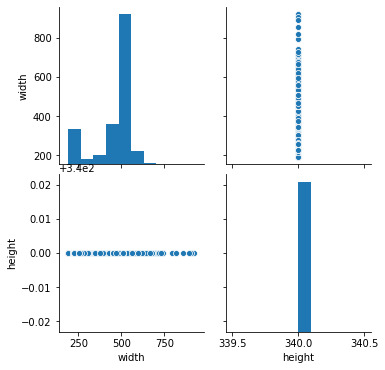

In [27]:
sns.pairplot(df[['width', 'height']]);

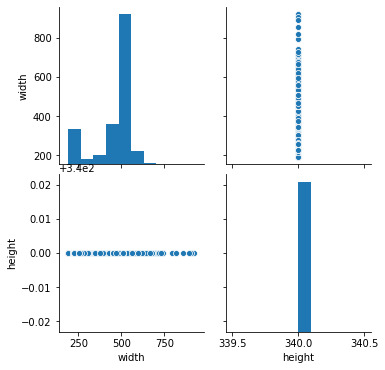

In [38]:
# for cute images
sns.pairplot(df[['width', 'height']]);

In [0]:
%matplotlib inline

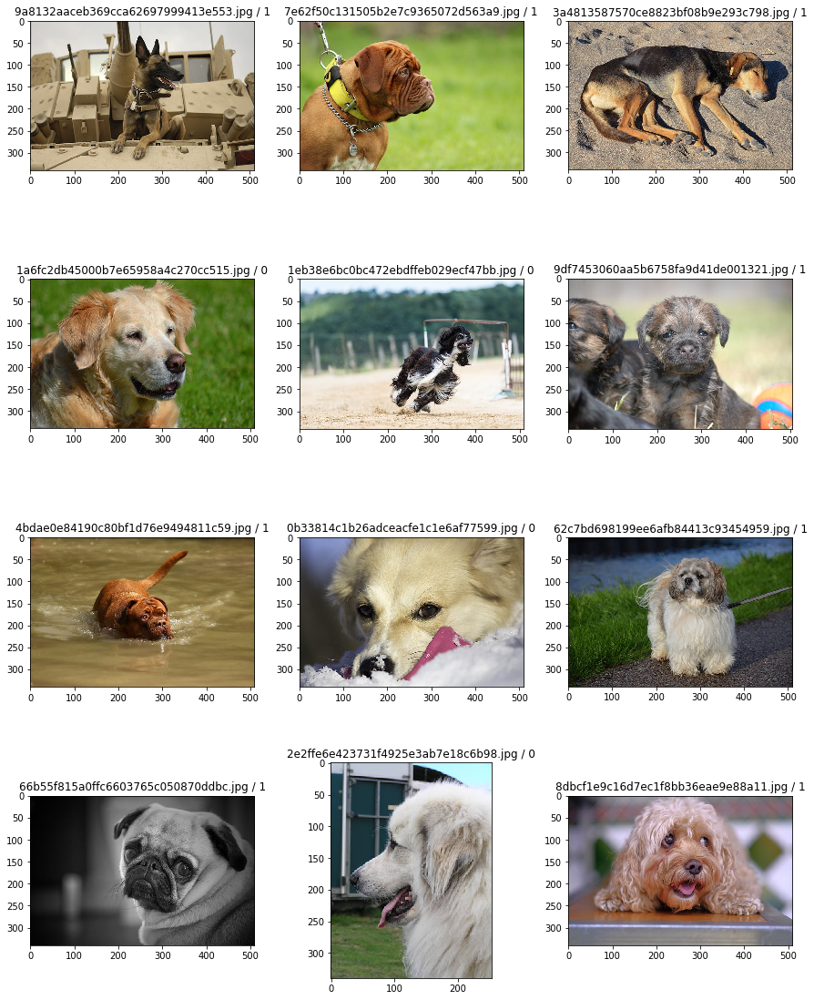

In [28]:
plot_df_images(df, 'filename', 12, label_column='category_id', random_plot=True)

## Preparing the dataset

In [0]:
BATCH_SIZE = 32
SHUFFLE_SIZE = 128
IMG_DIMS = (299, 299, 3)
N_IMAGES = df.shape[0]

In [0]:
train_data, validation_data, test_data = split_df(df, 0.2, "category_id")

In [31]:
train_data.category.value_counts()

cute_0    1642
cute_1    1596
Name: category, dtype: int64

In [32]:
 validation_data.category.value_counts()

cute_0    205
cute_1    200
Name: category, dtype: int64

In [33]:
test_data.category.value_counts()

cute_0    206
cute_1    199
Name: category, dtype: int64

In [0]:
train_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            train_data["filename"],
            train_data["category_id"].values,
        )
    )
    .map(ImageParser(), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .map(ImageResizer(IMG_DIMS, "stretch"), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    # .map(ImageAugmentor(level=0, rotate=False))
    .repeat()
    .shuffle(SHUFFLE_SIZE)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
validation_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            validation_data["filename"],
            validation_data["category_id"].values,

        )
    )
    .map(ImageParser(), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .map(ImageResizer(IMG_DIMS, "stretch"), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
test_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            test_data["filename"],
            test_data["category_id"].values,
        )
    )
    .map(ImageParser(), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .map(ImageResizer(IMG_DIMS, "stretch"), num_parallel_calls=tf.data.experimental.AUTOTUNE)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
def get_category_name(category_id: int, with_id: bool = False) -> str:
    return (
        f"{category_id} ({category_map[category_id]})"
        if with_id
        else category_map[category_id]
    )

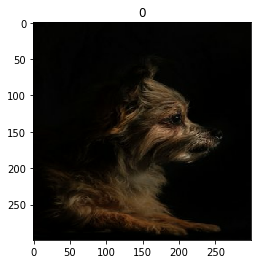

In [39]:
for x, y in train_set.take(1):
    n_image = 0
    categories = y
    category = categories[n_image].numpy()
    fig, ax = plt.subplots(1)
    ax.imshow(x[n_image].numpy())
    ax.set_title(category)
    plt.show()

In [0]:
n_categories = train_data["category"].nunique()

# Creating Xception model

In [0]:
class GlobalConcatPooling2D(keras.layers.Layer):
    def __call__(self, layer: keras.layers.Layer) -> keras.layers.Layer:
        return keras.layers.concatenate(
            [
                keras.layers.GlobalAvgPool2D()(layer),
                keras.layers.GlobalMaxPool2D()(layer),
            ]
        )

In [0]:
def make_model():
    base = tf.keras.applications.Xception(
        input_shape=IMG_DIMS, include_top=False, weights="imagenet"
    )
    x = GlobalConcatPooling2D()(base.output)
    x = keras.layers.Dropout(0.3)(x)
    category = keras.layers.Dense(1, activation=keras.activations.sigmoid)(x)
    model = keras.Model(inputs=base.input, outputs=category)
    model.compile(
        loss=keras.losses.BinaryCrossentropy(),
        optimizer=keras.optimizers.Adam(3e-4),
        metrics=[
                keras.metrics.binary_accuracy,
            ],
    )
    return model

In [43]:
model = make_model()

83689472/83683744 [==============================] - 1s 0us/step


In [44]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
______________________________________________________________________________________________

In [45]:
model.fit(
    x=train_set,
    validation_data=validation_set,
    steps_per_epoch=math.ceil(train_data.shape[0] / BATCH_SIZE),
    epochs=10,
    callbacks=[
        keras.callbacks.ModelCheckpoint(
            str(TEMP_DIR / "model2_get_pet.h5"), save_best_only=True, save_weights_only=True
        ),
        keras.callbacks.ReduceLROnPlateau(factor=0.3, patience=1),
        keras.callbacks.EarlyStopping(patience=5, restore_best_weights=True),
    ],
)

Train for 102 steps, validate for 13 steps
Epoch 1/10
102/102 [==============================] - 332s 3s/step - loss: 0.7062 - binary_accuracy: 0.5708 - val_loss: 0.6389 - val_binary_accuracy: 0.6247
Epoch 2/10
102/102 [==============================] - 313s 3s/step - loss: 0.5653 - binary_accuracy: 0.6967 - val_loss: 0.6615 - val_binary_accuracy: 0.6148
Epoch 3/10
102/102 [==============================] - 313s 3s/step - loss: 0.2653 - binary_accuracy: 0.8869 - val_loss: 0.7571 - val_binary_accuracy: 0.6346
Epoch 4/10
102/102 [==============================] - 313s 3s/step - loss: 0.0592 - binary_accuracy: 0.9838 - val_loss: 0.8363 - val_binary_accuracy: 0.6148
Epoch 5/10
102/102 [==============================] - 313s 3s/step - loss: 0.0249 - binary_accuracy: 0.9982 - val_loss: 0.9643 - val_binary_accuracy: 0.6222
Epoch 6/10
  4/102 [>.............................] - ETA: 4:52 - loss: 0.0186 - binary_accuracy: 1.0000WARNING:tensorflow:Can save best model only with val_loss available,

KeyboardInterrupt: ignored

In [0]:
def predict(model, dataset, n_image=0):
    for x, y in dataset.take(1):
        fig, ax = plt.subplots(1)
        ax.imshow(x[n_image].numpy())

        p_categories = model.predict(x)
        # print(p_categories)
        p_category = np.round(p_categories[n_image], 0)

        y_category = y[n_image].numpy()

        if p_category == y_category:
            label = f'correct prediction: {get_category_name(y_category)}'
            color = 'green'
        else:
            label = f'pred_label: {get_category_name(int(p_category))}, real: {get_category_name(int(y_category))}'
            color = 'yellow'

        plt.text(
            0,
            0,
            label,
            backgroundcolor=color,
            fontsize=16,
        )

        plt.show()

In [0]:
# for x, y in validation_set.take(1):
#     print(model.predict(x))
#     print(model.predict(x).shape)

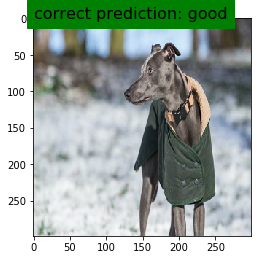

In [47]:
predict(model, validation_set, 8)

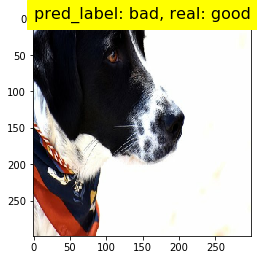

In [53]:
predict(model, validation_set, 10)

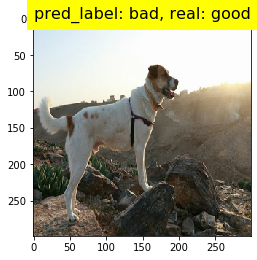

In [54]:
predict(model, validation_set, 13)

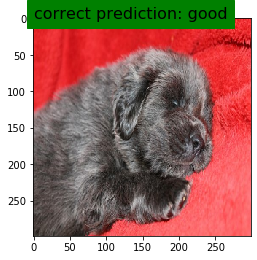

In [55]:
predict(model, validation_set, 25)

## Plot activations

In [0]:
def show_activation_maps(model, dataset, activation_layer_name, cols: int = 4):
    activation_map_model = keras.Model(
        inputs=model.input, outputs=model.get_layer(activation_layer_name).output
    )

    images, labels = next(iter(dataset))
    activation_maps = activation_map_model.predict(images)
    class_probs = model.predict(images)
    # predictions = class_probs.argmax(-1)
    predictions = np.round(class_probs, 0)

    rows = math.ceil(len(images) / cols)

    _, ax = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    for i, (image, label, activation_map, prediction) in enumerate(
        zip(images, labels, activation_maps, predictions)
    ):
        weights = model.layers[-1].get_weights()[0][:, prediction]
        weights1 = weights[..., :2048]
        weights2 = weights[..., 2048:]
        weights = weights1 + weights2
        class_activation_map = resize(
            activation_map.dot(weights), IMG_DIMS[:2], order=1
        )
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis("off")
        ax[idx].imshow(image, alpha=0.8)
        ax[idx].imshow(class_activation_map, cmap="jet", alpha=0.5)

        ax[idx].set_title(get_category_name(label.numpy()))

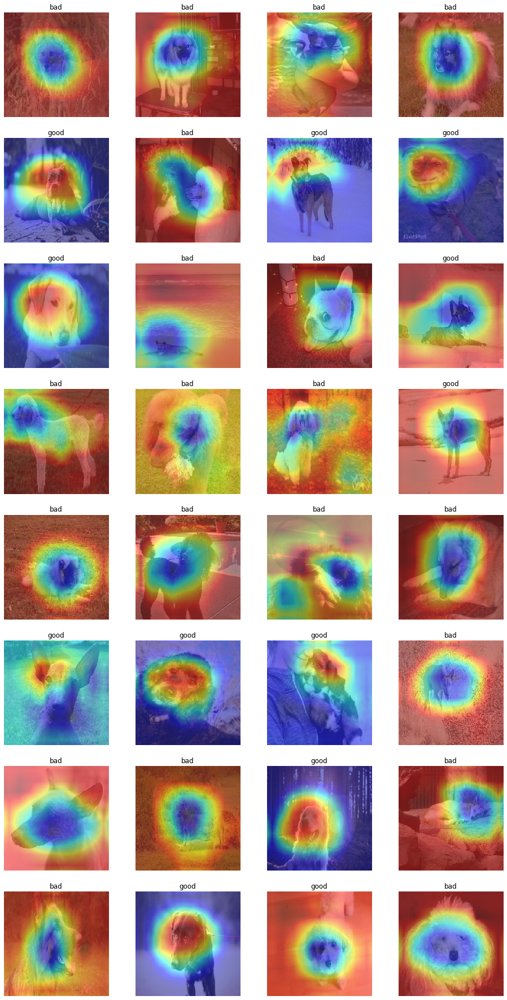

In [0]:
# global_average_pooling + global_max_pooling
show_activation_maps(model, validation_set, "block14_sepconv2_act")

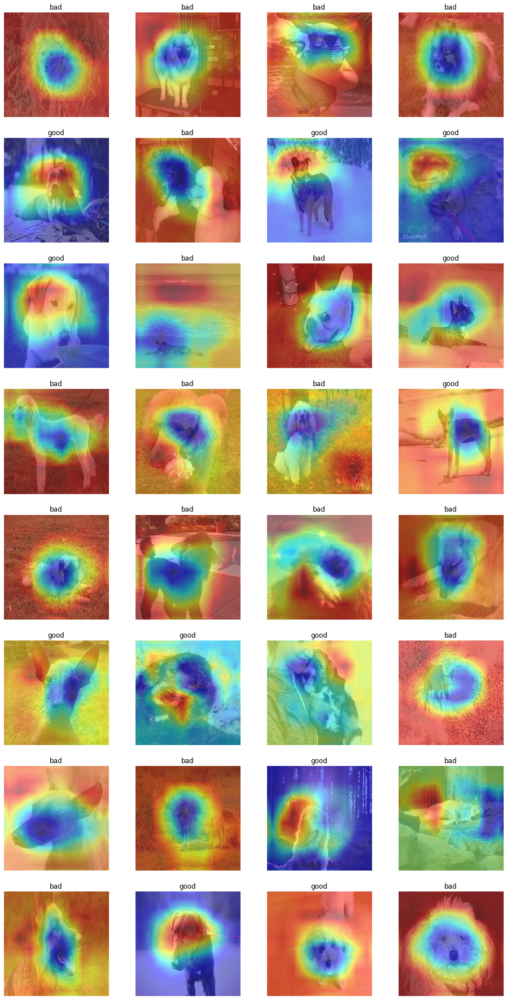

In [0]:
def show_activation_maps(model, dataset, activation_layer_name, cols: int = 4):
    activation_map_model = keras.Model(
        inputs=model.input, outputs=model.get_layer(activation_layer_name).output
    )

    images, labels = next(iter(dataset))
    activation_maps = activation_map_model.predict(images)
    class_probs = model.predict(images)
    predictions = np.round(class_probs, 0)

    rows = math.ceil(len(images) / cols)

    _, ax = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    for i, (image, label, activation_map, prediction) in enumerate(
        zip(images, labels, activation_maps, predictions)
    ):
        weights = model.layers[-1].get_weights()[0][:, prediction]
        weights = weights[..., :2048]
        # weights2 = weights[..., 2048:]
        # weights = weights1 + weights2
        class_activation_map = resize(
            activation_map.dot(weights), IMG_DIMS[:2], order=1
        )
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis("off")
        ax[idx].imshow(image, alpha=0.8)
        ax[idx].imshow(class_activation_map, cmap="jet", alpha=0.5)

        ax[idx].set_title(get_category_name(label.numpy()))
# with global_average_pooling weights
show_activation_maps(model, validation_set, "block14_sepconv2_act")

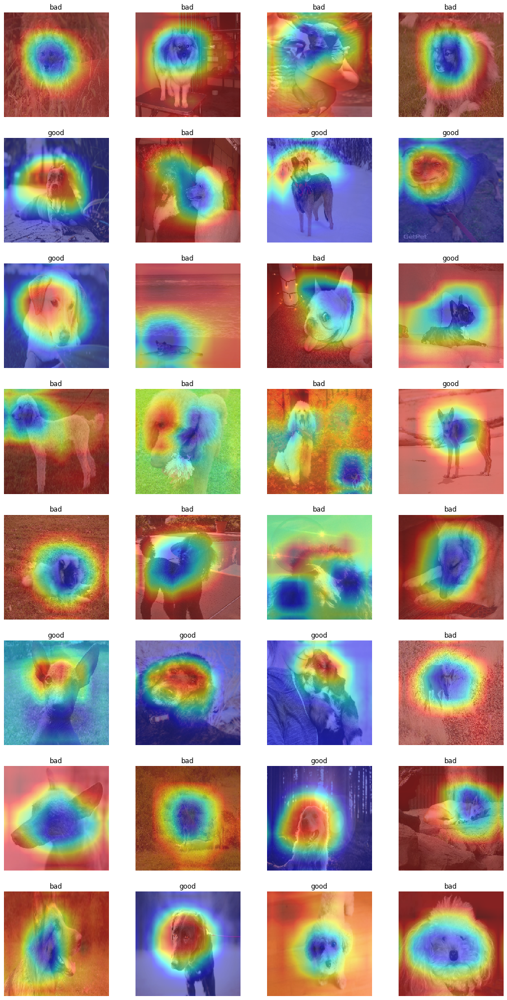

In [0]:
def show_activation_maps(model, dataset, activation_layer_name, cols: int = 4):
    activation_map_model = keras.Model(
        inputs=model.input, outputs=model.get_layer(activation_layer_name).output
    )

    images, labels = next(iter(dataset))
    activation_maps = activation_map_model.predict(images)
    class_probs = model.predict(images)
    predictions = np.round(class_probs, 0)

    rows = math.ceil(len(images) / cols)

    _, ax = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    for i, (image, label, activation_map, prediction) in enumerate(
        zip(images, labels, activation_maps, predictions)
    ):
        weights = model.layers[-1].get_weights()[0][:, prediction]
        weights = weights[..., 2048:]
        class_activation_map = resize(
            activation_map.dot(weights), IMG_DIMS[:2], order=1
        )
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis("off")
        ax[idx].imshow(image, alpha=0.8)
        ax[idx].imshow(class_activation_map, cmap="jet", alpha=0.5)

        ax[idx].set_title(get_category_name(label.numpy()))
# with global_max_pooling weights
show_activation_maps(model, validation_set, "block14_sepconv2_act")

## Make classification report

In [0]:
def make_report(model, dataset):
    print(
        classification_report(
            [category.numpy() for _, category in dataset.unbatch()],
            np.round(model.predict(dataset), 0),
            target_names=list(category_map.values()),
        )
    )

In [57]:
make_report(model, validation_set)

              precision    recall  f1-score   support

         bad       0.64      0.58      0.61       205
        good       0.61      0.67      0.63       200

    accuracy                           0.62       405
   macro avg       0.62      0.62      0.62       405
weighted avg       0.62      0.62      0.62       405



In [58]:
make_report(model, test_set)

              precision    recall  f1-score   support

         bad       0.65      0.54      0.59       206
        good       0.59      0.69      0.64       199

    accuracy                           0.62       405
   macro avg       0.62      0.62      0.62       405
weighted avg       0.62      0.62      0.62       405



In [0]:
def analyse_dataset(model, dataset, verbose: int = 0):
    images = [x.numpy() for x, _ in dataset.unbatch()]
    probs = model.predict(dataset)
    # print(probs)
    pred_code = probs.argmax(axis=1)
    label_code = [int(category.numpy()) for _, category in dataset.unbatch()]
    # print(label_code)
    return pd.DataFrame.from_dict(
        {
            "image": images,
            "label": label_code,
            "pred": pred_code,
            "label_probs": probs[:, label_code][np.eye(len(label_code), dtype=bool)],
            "pred_probs": probs[:, pred_code][np.eye(len(pred_code), dtype=bool)],
        }
    )

In [0]:
probs = model.predict(validation_set)
probs

array([[2.90336341e-01],
       [1.34927019e-01],
       [2.36880735e-01],
       [6.56905025e-02],
       [9.99894619e-01],
       [3.14667495e-03],
       [4.11112368e-01],
       [9.90862489e-01],
       [9.99958277e-01],
       [7.06777453e-01],
       [5.71259975e-01],
       [9.41270232e-01],
       [9.64617077e-03],
       [1.80922344e-01],
       [2.01865926e-01],
       [5.14979899e-01],
       [1.95963960e-03],
       [1.56522505e-02],
       [9.95180249e-01],
       [4.09911834e-02],
       [5.21408141e-01],
       [9.35590446e-01],
       [9.98178482e-01],
       [3.85760027e-03],
       [3.03249836e-01],
       [3.41990329e-02],
       [9.99918461e-01],
       [1.54431656e-01],
       [9.56187025e-02],
       [9.99994993e-01],
       [9.97567058e-01],
       [6.98225737e-01],
       [2.10927054e-01],
       [9.87178087e-01],
       [9.99379873e-01],
       [7.86456764e-01],
       [9.62838158e-03],
       [2.33657837e-01],
       [7.99865946e-02],
       [3.45219254e-01],


In [0]:
pred_code = probs.argmax(axis=1)
pred_code

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [0]:
label_code = [int(category.numpy()) for _, category in validation_set.unbatch()]
len(label_code)

167

In [0]:
probs[label_code][np.eye(len(label_code), dtype=bool)]

array([[0.29033634],
       [0.29033634],
       [0.29033634],
       [0.29033634],
       [0.13492702],
       [0.29033634],
       [0.13492702],
       [0.13492702],
       [0.13492702],
       [0.29033634],
       [0.29033634],
       [0.13492702],
       [0.29033634],
       [0.29033634],
       [0.29033634],
       [0.13492702],
       [0.29033634],
       [0.29033634],
       [0.29033634],
       [0.29033634],
       [0.13492702],
       [0.13492702],
       [0.13492702],
       [0.29033634],
       [0.29033634],
       [0.29033634],
       [0.13492702],
       [0.29033634],
       [0.29033634],
       [0.13492702],
       [0.13492702],
       [0.29033634],
       [0.29033634],
       [0.13492702],
       [0.13492702],
       [0.13492702],
       [0.29033634],
       [0.29033634],
       [0.29033634],
       [0.29033634],
       [0.13492702],
       [0.13492702],
       [0.13492702],
       [0.29033634],
       [0.13492702],
       [0.29033634],
       [0.13492702],
       [0.290

In [0]:
analyse_dataset(model, validation_set)

IndexError: ignored

In [0]:
def show_predictions(
    model,
    dataset,
    correct: bool = False,
    ascending: bool = True,
    cols: int = 8,
    rows: int = 2,
):
    df = analyse_dataset(model, dataset)
    df = df[(df.label == df.pred) if correct else (df.label != df.pred)]
    df.sort_values(by=["label_probs"], ascending=ascending, inplace=True)
    _, ax = plt.subplots(rows, cols, figsize=(3 * cols, 3.5 * rows))
    for i, row in enumerate(df.head(cols * rows).itertuples()):
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis("off")
        ax[idx].imshow(row.image)
        ax[idx].set_title(
            f"{get_category_name(row.label)}\n{get_category_name(row.pred)}\n{row.label_probs:.4f}:{row.pred_probs:.4f}"
        )

In [0]:
show_predictions(model, validation_set)

[0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0]


KeyError: ignored

# Creating ResNet model

In [0]:
class GlobalConcatPooling2D(keras.layers.Layer):
    def __call__(self, layer: keras.layers.Layer) -> keras.layers.Layer:
        return keras.layers.concatenate(
            [
                keras.layers.GlobalAvgPool2D()(layer),
                keras.layers.GlobalMaxPool2D()(layer),
            ]
        )

In [0]:
def make_model():
    base = keras.applications.ResNet50V2(
        input_shape=IMG_DIMS, include_top=False, weights="imagenet"
    )
    x = keras.layers.GlobalMaxPool2D()(base.output)
    x = keras.layers.Dropout(0.3)(x)
    category = keras.layers.Dense(1, activation=keras.activations.sigmoid)(x)
    model = keras.Model(inputs=base.input, outputs=category)
    model.compile(
        loss=keras.losses.BinaryCrossentropy(),
        optimizer=keras.optimizers.Adam(3e-4),
        metrics=[
                keras.metrics.binary_accuracy,
            ],
    )
    return model

In [0]:
model = make_model()

94674944/94668760 [==============================] - 7s 0us/step


In [0]:
model.summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 305, 305, 3)  0           input_2[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 150, 150, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
pool1_pad (ZeroPadding2D)       (None, 152, 152, 64) 0           conv1_conv[0][0]                 
____________________________________________________________________________________________

In [0]:
model.fit(
    x=train_set,
    validation_data=validation_set,
    steps_per_epoch=math.ceil(train_data.shape[0] / BATCH_SIZE),
    epochs=10,
    callbacks=[
        keras.callbacks.ModelCheckpoint(
            str(TEMP_DIR / "model_resnet.h5"), save_best_only=True, save_weights_only=True
        ),
        keras.callbacks.ReduceLROnPlateau(factor=0.3, patience=2),
        keras.callbacks.EarlyStopping(patience=3, restore_best_weights=True),
    ],
)


Train for 42 steps, validate for 6 steps
Epoch 1/10
42/42 [==============================] - 20s 479ms/step - loss: 2.6611 - binary_accuracy: 0.7150 - val_loss: 9.7744 - val_binary_accuracy: 0.6347
Epoch 2/10
42/42 [==============================] - 13s 309ms/step - loss: 0.8882 - binary_accuracy: 0.8542 - val_loss: 3.3450 - val_binary_accuracy: 0.7605
Epoch 3/10
42/42 [==============================] - 13s 320ms/step - loss: 0.4346 - binary_accuracy: 0.9062 - val_loss: 1.9735 - val_binary_accuracy: 0.8204
Epoch 4/10
42/42 [==============================] - 12s 288ms/step - loss: 0.1740 - binary_accuracy: 0.9680 - val_loss: 2.1555 - val_binary_accuracy: 0.7964
Epoch 5/10
42/42 [==============================] - 13s 318ms/step - loss: 0.1355 - binary_accuracy: 0.9568 - val_loss: 1.8115 - val_binary_accuracy: 0.8144
Epoch 6/10
42/42 [==============================] - 14s 322ms/step - loss: 0.0929 - binary_accuracy: 0.9762 - val_loss: 1.7184 - val_binary_accuracy: 0.8024
Epoch 7/10
42/42 

In [0]:
def predict(model, dataset, n_image=0):
    for x, y in dataset.take(1):
        fig, ax = plt.subplots(1)
        ax.imshow(x[n_image].numpy())

        p_categories, p_bounding_boxes = model.predict(x)
        p_category = p_categories[n_image].argmax()
        p_bounding_box = p_bounding_boxes[n_image]
        plt.text(
            (p_bounding_box[0] + p_bounding_box[2]) * IMG_DIMS[0] - 25,
            p_bounding_box[1] * IMG_DIMS[1],
            get_category_name(p_category),
            color="white",
            backgroundcolor="blue",
            fontsize=16,
        )
        p_rect = make_rectangle(*p_bounding_box, IMG_DIMS, "b", 3)
        ax.add_patch(p_rect)

        y_categories, y_bounding_boxes = y
        y_category = y_categories[n_image].numpy()
        y_bounding_box = y_bounding_boxes[n_image].numpy()
        plt.text(
            y_bounding_box[0] * IMG_DIMS[0] + 5,
            y_bounding_box[1] * IMG_DIMS[1],
            get_category_name(y_category),
            backgroundcolor="red",
            fontsize=16,
        )
        y_rect = make_rectangle(*y_bounding_box, IMG_DIMS, "r")
        ax.add_patch(y_rect)

        plt.show()

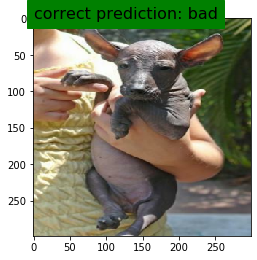

In [0]:
predict(model, validation_set, 2)

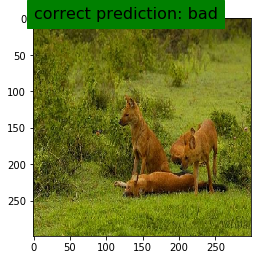

In [0]:
predict(model, validation_set, 25)

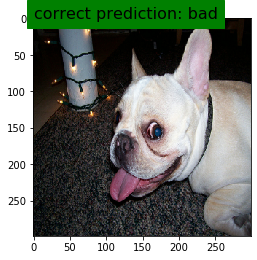

In [0]:
predict(model, validation_set, 10)

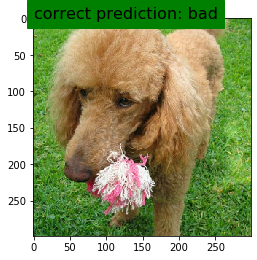

In [0]:
predict(model, validation_set, 13)

In [0]:
def show_activation_maps(model, dataset, activation_layer_name, cols: int = 4):
    activation_map_model = keras.Model(
        inputs=model.input, outputs=model.get_layer(activation_layer_name).output
    )

    images, labels = next(iter(dataset))
    activation_maps = activation_map_model.predict(images)
    class_probs = model.predict(images)
    predictions = class_probs.argmax(-1)

    rows = math.ceil(len(images) / cols)

    _, ax = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    for i, (image, label, activation_map, prediction) in enumerate(
        zip(images, labels, activation_maps, predictions)
    ):
        weights = model.layers[-1].get_weights()[0][:, prediction]
        class_activation_map = resize(
            activation_map.dot(weights), IMG_DIMS[:2], order=1
        )
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis("off")
        ax[idx].imshow(image, alpha=0.8)
        ax[idx].imshow(class_activation_map, cmap="jet", alpha=0.5)

        ax[idx].set_title(get_category_name(label.numpy()))
        ax[idx].set_title(get_category_name(label.numpy()))

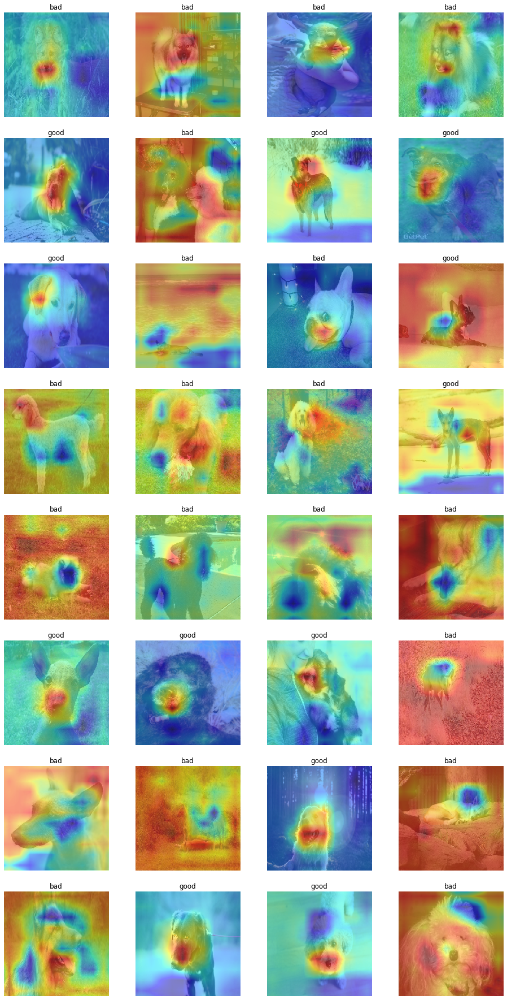

In [0]:
show_activation_maps(model, validation_set, "post_relu")

In [0]:
def make_report(model, dataset):
    print(
        classification_report(
            [category.numpy() for _, category in dataset.unbatch()],
            model.predict(dataset).argmax(axis=1),
            target_names=list(category_map.values()),
        )
    )

In [0]:
make_report(model, validation_set)

              precision    recall  f1-score   support

         bad       0.61      1.00      0.76       102
        good       0.00      0.00      0.00        65

    accuracy                           0.61       167
   macro avg       0.31      0.50      0.38       167
weighted avg       0.37      0.61      0.46       167



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [0]:
make_report(model, test_set)

                                          precision    recall  f1-score   support

                  n02091244-Ibizan_hound       0.71      0.89      0.79        19
                       n02090379-redbone       0.55      0.80      0.65        15
            n02099712-Labrador_retriever       0.50      0.71      0.59        17
                         n02115641-dingo       1.00      0.94      0.97        16
                    n02106550-Rottweiler       0.78      0.93      0.85        15
                      n02110063-malamute       0.67      0.67      0.67        18
                n02102480-Sussex_spaniel       0.93      0.87      0.90        15
             n02091032-Italian_greyhound       0.65      0.72      0.68        18
                 n02093991-Irish_terrier       0.69      0.65      0.67        17
          n02107683-Bernese_mountain_dog       0.80      0.91      0.85        22
                        n02104029-kuvasz       0.80      0.53      0.64        15
             n0

In [0]:
def analyse_dataset(model, dataset, verbose: int = 0):
    images = [x.numpy() for x, _ in dataset.unbatch()]
    probs = model.predict(dataset)[0]
    pred_code = probs.argmax(axis=1)
    label_code = [int(category.numpy()) for _, (category, _) in dataset.unbatch()]
    return pd.DataFrame.from_dict(
        {
            "image": images,
            "label": label_code,
            "pred": pred_code,
            "label_probs": probs[:, label_code][np.eye(len(label_code), dtype=bool)],
            "pred_probs": probs[:, pred_code][np.eye(len(pred_code), dtype=bool)],
        }
    )

In [0]:
analyse_dataset(model, validation_set)

image  ...  pred_probs
0     [[[0.42027378, 0.38497967, 0.3261561], [0.42402783, 0.3887337, 0.32991016], [0.42436704, 0.38907292, 0.33024937], [0.4279494, 0.39265528, 0.33383173], [0.42834944, 0.39305532, 0.33423176], [0.4269133, 0.39161918, 0.33279562], [0.43187097, 0.39657685, 0.3377533], [0.43187097, 0.39657685, 0.3377533], [0.42907077, 0.39377666, 0.3349531], [0.42755595, 0.38771728, 0.32256544], [0.43236938, 0.38923213, 0.31864387], [0.43236938, 0.38923213, 0.31864387], [0.43236938, 0.38923213, 0.31864387], [0.43236938, 0.38923213, 0.31864387], [0.43418306, 0.3910458, 0.32045755], [0.4029497, 0.3598124, 0.28922418], [0.35355747, 0.31042022, 0.23983198], [0.325199, 0.28206176, 0.21147354], [0.32039464, 0.2755458, 0.19811118], [0.38030866, 0.30278367, 0.19574884], [0.38920555, 0.301506, 0.18093416], [0.38789722, 0.2941001, 0.17557795], [0.3863602, 0.28647864, 0.16889407], [0.39185438, 0.27833053, 0.16078432], [0.3945862, 0.27354595, 0.15270989], [0.41987538, 0.283048, 0.16625604], [0.42529935, 0.28525665, 0.16203402], [0.4164788, 0.26980656, 0.14747733], [0.40156013, 0.26054198, 0.1279679], [0.41176474, 0.27768928, 0.13532251], [0.42428195, 0.29094526, 0.15493798], [0.4425209, 0.2982446, 0.18428321], [0.4556365, 0.31053844, 0.20361425], [0.45212933, 0.30703127, 0.19758834], [0.44243407, 0.2988443, 0.18285635], [0.431042, 0.29717746, 0.16151606], [0.4125634, 0.28525668, 0.14168659], [0.39325786, 0.27568218, 0.120137535], [0.4169654, 0.2676043, 0.13414043], [0.42464995, 0.26603627, 0.13403414], [0.43341863, 0.27389994, 0.13664503], [0.44248968, 0.2738622, 0.1366073], [0.42544654, 0.26052642, 0.11214939], [0.43986118, 0.26731214, 0.11512604], [0.4311661, 0.2617483, 0.09941342], [0.4223111, 0.25368363, 0.08897775], [0.4255427, 0.25691524, 0.09119287], [0.428912, 0.25663182, 0.102615245], [0.44780982, 0.2713392, 0.14765899], [0.46075746, 0.28536892, 0.15947203], [0.46399972, 0.28401408, 0.14304088], [0.4415069, 0.26503628, 0.10463035], [0.4479648, 0.27149418, 0.107935905], [0.4516493, 0.2751787, 0.114394374], [0.4164536, 0.24390455, 0.103803545], [0.47958574, 0.30974507, 0.18789446], [0.54352164, 0.37097263, 0.27264488], [0.55848, 0.38145456, 0.27815545], [0.5451274, 0.37897226, 0.26524678], [0.483116, 0.34633243, 0.22968706], [0.5050834, 0.40058473, 0.28552145], [0.5710463, 0.48453572, 0.36279622], [0.62871295, 0.55012697, 0.42076674], [0.64067155, 0.54824775, 0.41721115], [0.6618054, 0.5396202, 0.4091068], [0.5546517, 0.40452647, 0.2650469], [0.55010825, 0.38389075, 0.24056661], [0.5424958, 0.38314912, 0.22939204], [0.5518964, 0.39895523, 0.24601403], [0.55494946, 0.39918187, 0.25471997], [0.5565876, 0.40126595, 0.26471278], [0.79609305, 0.6551723, 0.5228621], [0.8042499, 0.678563, 0.5580239], [0.7903348, 0.68072116, 0.5677039], [0.613927, 0.5214162, 0.41096953], [0.57375807, 0.50516343, 0.3934315], [0.5826325, 0.5232319, 0.42127115], [0.56625354, 0.50980395, 0.408617], [0.5864385, 0.50980395, 0.40661684], [0.5512492, 0.4519181, 0.33863848], [0.5194571, 0.40000004, 0.26530918], [0.5329408, 0.39343, 0.25142068], [0.5442394, 0.38800615, 0.24110466], [0.56524366, 0.40053782, 0.2515182], [0.57520497, 0.4104991, 0.26147947], [0.5643911, 0.39968523, 0.2469276], [0.5780575, 0.40275428, 0.24138628], [0.5808054, 0.40895808, 0.2667915], [0.63965684, 0.48661074, 0.37079343], [0.86536825, 0.7339826, 0.6268017], [0.8391107, 0.73396945, 0.607102], [0.8473556, 0.75723827, 0.60221815], [0.80740494, 0.7328951, 0.5696189], [0.8854238, 0.8075629, 0.66745543], [0.55284196, 0.46842325, 0.36131477], [0.49253735, 0.41332558, 0.32310995], [0.49171087, 0.41960788, 0.3416814], [0.48201188, 0.41142365, 0.33299226], [0.47450984, 0.4039216, 0.3254902], [0.47450984, 0.4039216, 0.3254902], ...], [[0.42883056, 0.39353645, 0.3347129], [0.43044138, 0.39514726, 0.3363237], [0.43311042, 0.3978163, 0.33899274], [0.4348905, 0.3995964, 0.34077284], [0.43818614, 0.40289202, 0.34406847], [0.43540555, 0.40011144, 0.34128788], [0.43883708, 0.40354297, 0.3447194], [0.43

In [0]:
def show_predictions(
    model,
    dataset,
    correct: bool = False,
    ascending: bool = True,
    cols: int = 8,
    rows: int = 2,
):
    df = analyse_dataset(model, dataset)
    df = df[(df.label == df.pred) if correct else (df.label != df.pred)]
    df.sort_values(by=["label_probs"], ascending=ascending, inplace=True)
    _, ax = plt.subplots(rows, cols, figsize=(3 * cols, 3.5 * rows))
    for i, row in enumerate(df.head(cols * rows).itertuples()):
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis("off")
        ax[idx].imshow(row.image)
        ax[idx].set_title(
            f"{get_category_name(row.label)}\n{get_category_name(row.pred)}\n{row.label_probs:.4f}:{row.pred_probs:.4f}"
        )

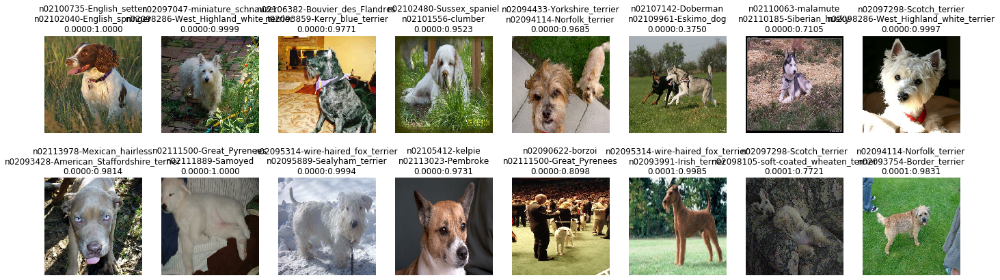

In [0]:
show_predictions(model, validation_set)